Распознание слов-активаций("триггеров") - это технология, которая позволяет таким устройствам, как Amazon Alexa, Google Home, Apple Siri и Baidu DuerOS, просыпаться, услышав определенное слово.

Для этого проекта триггерным словом будет "активировать" на английском языке. Каждый раз, когда он услышит "активировать", он будет издавать звук

# **Содержание**

- [1 - Подготовка к работе](#1)
    - [1.1 - Установка необходимых библиотек](#1-1)
    - [1.2 - Подключение данных через Google Drive](#1-2)
- [2 - Синтез данных](#2)
    - [2.1 - Перевод аудиозаписей в спектрограммы](#2-1)
    - [2.2 - Генерация аудиозаписи](#2-2)
    - [2.3 - Создание датасета](#2-3)
- [3 - Построение модели и запуск](#3)
    - [3.1 - Построение модели](#3-1)
    - [3.2 - Fine-tune](#3-2)
    - [3.3 - Тестирование модели](#3-3)
    - [3.4 - Составление прогнозов](#3-4)
    - [3.5 - Попробуйте свою аудиозапись](#3-5)

<a name='1'></a>
# **Подготовка к работе**

In [ ]:
!pip install pydub

In [ ]:
import numpy as np
from pydub import AudioSegment
import random
import sys
import io
import os
import glob
import IPython
%matplotlib inline

Вспомогательные функции для работы с аудио:

In [ ]:
import matplotlib.pyplot as plt
from scipy.io import wavfile

# Calculate and plot spectrogram for a wav audio file
def graph_spectrogram(wav_file):
    rate, data = get_wav_info(wav_file)
    nfft = 200 # Length of each window segment
    fs = 8000 # Sampling frequencies
    noverlap = 120 # Overlap between windows
    nchannels = data.ndim
    if nchannels == 1:
        pxx, freqs, bins, im = plt.specgram(data, nfft, fs, noverlap = noverlap)
    elif nchannels == 2:
        pxx, freqs, bins, im = plt.specgram(data[:,0], nfft, fs, noverlap = noverlap)
    return pxx

# Load a wav file
def get_wav_info(wav_file):
    rate, data = wavfile.read(wav_file)
    return rate, data

# Used to standardize volume of audio clip
def match_target_amplitude(sound, target_dBFS):
    change_in_dBFS = target_dBFS - sound.dBFS
    return sound.apply_gain(change_in_dBFS)

# Load raw audio files for speech synthesis
def load_raw_audio(path):
    activates = []
    backgrounds = []
    negatives = []
    for filename in os.listdir(path + "activates"):
        if filename.endswith("wav"):
            activate = AudioSegment.from_wav(path + "activates/" + filename)
            activates.append(activate)
    for filename in os.listdir(path + "backgrounds"):
        if filename.endswith("wav"):
            background = AudioSegment.from_wav(path + "backgrounds/" + filename)
            backgrounds.append(background)
    for filename in os.listdir(path + "negatives"):
        if filename.endswith("wav"):
            negative = AudioSegment.from_wav(path + "negatives/" + filename)
            negatives.append(negative)
    return activates, negatives, backgrounds

<a name='1-2'></a>
## Подключение данных через Google Drive

Для проекта нам понадобятся файлы
Папка с ними находится в открытом доступе, добавьте её на свой Google Drive

[Ссылка на папку](https://drive.google.com/drive/folders/1pBPZR6oSIJmY04v2gBuDTF7ZjDrR5cIb?usp=sharing)


In [ ]:
from google.colab import drive #добавление файлов из drive
drive.mount('/content/drive')


Mounted at /content/drive


Проверим, что всё подключилось верно:

Каталог "activate"содержит положительные примеры того, как люди произносят слово "активировать".


Каталог "negatives" содержит негативные примеры того, как люди произносят случайные слова, отличные от "активировать".


На аудиозапись приходится по одному слову.


Каталог "backgrounds" содержит 10-секундные клипы с фоновым шумом в различных средах.

(возможно вам потребуется изменить путь, зависит от места сохранения)


In [ ]:
IPython.display.Audio("/content/drive/MyDrive/projTriggerWord/raw_data/activates/1.wav")

In [ ]:
IPython.display.Audio("/content/drive/MyDrive/projTriggerWord/raw_data/negatives/5.wav")

In [ ]:
IPython.display.Audio("/content/drive/MyDrive/projTriggerWord/raw_data/backgrounds/1.wav")

<a name='2'></a>
# **2 - Синтез данных**

Набор речевых данных должен быть как можно ближе к приложению, в котором вы хотите его запустить.
В этом случае будем обнаружить слово "активировать" в рабочей среде (библиотека, дом, офисы)
Следовательно, необходимо создавать записи со смесью положительных слов ("активировать") и отрицательных слов (случайные слова, отличные от "активировать") на разных фоновых звуках.

You will use these three types of recordings (positives/negatives/backgrounds) to create a labeled dataset.

<a name='2-1'></a>
## 2.1 - Перевод аудиозаписей в спектрограммы

Чтобы помочь модели легче научиться распознавать триггерные слова, мы вычислим спектрограмму звука.
Спектрограмма показывает нам, сколько различных частот присутствует в аудиоклипе в любой момент времени.

Пример:

In [ ]:
IPython.display.Audio("/content/drive/MyDrive/projTriggerWord/audio_examples/example_train.wav")

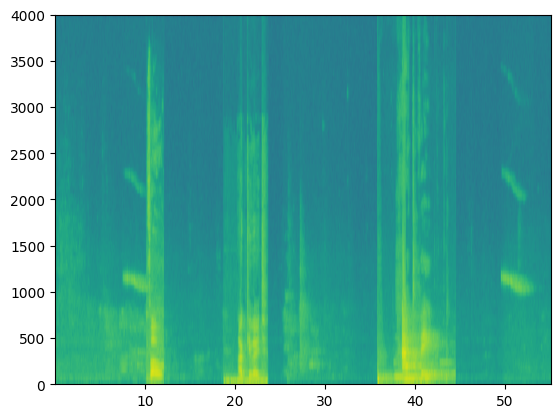

In [ ]:
x = graph_spectrogram("/content/drive/MyDrive/projTriggerWord/audio_examples/example_train.wav")

In [ ]:
_, data = wavfile.read("/content/drive/MyDrive/projTriggerWord/audio_examples/example_train.wav")
print("Time steps in audio recording before spectrogram", data[:,0].shape)
print("Time steps in input after spectrogram", x.shape)

Time steps in audio recording before spectrogram (441000,)
Time steps in input after spectrogram (101, 5511)


In [ ]:
Tx = 5511 # The number of time steps input to the model from the spectrogram
n_freq = 101 # Number of frequencies input to the model at each time step of the spectrogram

Выходные данные нашей модели разделят 10 секунд на 1375 единиц

In [ ]:
Ty = 1375 # The number of time steps in the output of our model

<a name='2-2'></a>
## 2.2 - Генерация аудиозаписи

Поскольку речевые данные трудно получить и обозначить, мы синтезируем свои обучающие данные, используя аудиоклипы с активациями, негативами и фоном.

**Процесс синтеза**
* Чтобы синтезировать один обучающий пример, необходимо:
    - Выбрать случайный 10-секундный фоновый аудиоклип
    - Случайным образом вставить 0-4 аудиоклипа "активировать" в этот 10-секундный клип
    - Случайным образом вставьте 0-2 аудиоклипа с негативными словами в этот 10-секундный клип
Поскольку мы синтезировали слово "активировать" в фоновом клипе, мы точно знаем, когда в 10-секундном клипе появляется слово "активировать".

In [ ]:
# Load audio segments using pydub
activates, negatives, backgrounds = load_raw_audio('/content/drive/MyDrive/projTriggerWord/raw_data/')

print("background len should be 10,000, since it is a 10 sec clip\n" + str(len(backgrounds[0])),"\n")
print("activate[0] len may be around 1000, since an `activate` audio clip is usually around 1 second (but varies a lot) \n" + str(len(activates[0])),"\n")
print("activate[1] len: different `activate` clips can have different lengths\n" + str(len(activates[1])),"\n")

background len should be 10,000, since it is a 10 sec clip
10000 

activate[0] len may be around 1000, since an `activate` audio clip is usually around 1 second (but varies a lot) 
2392 

activate[1] len: different `activate` clips can have different lengths
668 



**Получим случайный временной отрезок**

In [ ]:
def get_random_time_segment(segment_ms):
    """
    Gets a random time segment of duration segment_ms in a 10,000 ms audio clip.

    Arguments:
    segment_ms -- the duration of the audio clip in ms ("ms" stands for "milliseconds")

    Returns:
    segment_time -- a tuple of (segment_start, segment_end) in ms
    """

    segment_start = np.random.randint(low=0, high=10000-segment_ms)   # Make sure segment doesn't run past the 10sec background
    segment_end = segment_start + segment_ms - 1

    return (segment_start, segment_end)

**Проверим, не перекрываются ли аудиоклипы**
Перекрытие, если:
Новый сегмент начинается до окончания предыдущего сегмента и
Новый сегмент заканчивается после начала предыдущего сегмента.

In [ ]:
def is_overlapping(segment_time, previous_segments):
    """
    Checks if the time of a segment overlaps with the times of existing segments.

    Arguments:
    segment_time -- a tuple of (segment_start, segment_end) for the new segment
    previous_segments -- a list of tuples of (segment_start, segment_end) for the existing segments

    Returns:
    True if the time segment overlaps with any of the existing segments, False otherwise
    """

    segment_start, segment_end = segment_time

    # Step 1: Initialize overlap as a "False" flag. (≈ 1 line)
    overlap = False

    # Step 2: loop over the previous_segments start and end times.
    # Compare start/end times and set the flag to True if there is an overlap (≈ 3 lines)
    for previous_start, previous_end in previous_segments:
        if segment_time[0]<=previous_end and segment_time[1]>=previous_start:
            overlap = True
            break

    return overlap

In [ ]:
overlap1 = is_overlapping((950, 1430), [(2000, 2550), (260, 949)])
overlap2 = is_overlapping((2305, 2950), [(824, 1532), (1900, 2305), (3424, 3656)])
print("Overlap 1 = ", overlap1)
print("Overlap 2 = ", overlap2)

Overlap 1 =  False
Overlap 2 =  True


**Вставим аудио**
4 шага:

1)Получить случайный временной отрезок, длительность которого равна длительности аудиоклипа, который должен быть вставлен.


2)Убедится, что временной сегмент не перекрывается ни с одним из предыдущих временных сегментов.
Если они перекрываются, вернутся к шагу 1 и выбрать новый временной сегмент.


3)Добавить новый временной сегмент к списку существующих временных сегментов
При этом будут отслеживаться все вставленные вами сегменты.


4)Наложить аудиоклип поверх фона с помощью psydub.

In [ ]:
def insert_audio_clip(background, audio_clip, previous_segments):
    """
    Insert a new audio segment over the background noise at a random time step, ensuring that the
    audio segment does not overlap with existing segments.

    Arguments:
    background -- a 10 second background audio recording.
    audio_clip -- the audio clip to be inserted/overlaid.
    previous_segments -- times where audio segments have already been placed

    Returns:
    new_background -- the updated background audio
    """

    # Get the duration of the audio clip in ms
    segment_ms = len(audio_clip)

    # Step 1: Use one of the helper functions to pick a random time segment onto which to insert
    # the new audio clip. (≈ 1 line)
    segment_time = get_random_time_segment(segment_ms)

    # Step 2: Check if the new segment_time overlaps with one of the previous_segments. If so, keep
    # picking new segment_time at random until it doesn't overlap. To avoid an endless loop
    # we retry 5 times(≈ 2 lines)
    retry = 5
    while is_overlapping(segment_time, previous_segments)==True and retry >= 0:
        segment_time = get_random_time_segment(segment_ms)
        retry = retry - 1
        #print(segment_time)
    # if last try is not overlaping, insert it to the background
    if not is_overlapping(segment_time, previous_segments):
        # Step 3: Append the new segment_time to the list of previous_segments (≈ 1 line)
        previous_segments.append(segment_time)
        # Step 4: Superpose audio segment and background
        new_background = background.overlay(audio_clip, position = segment_time[0])
    else:
        #print("Timeouted")
        new_background = background
        segment_time = (10000, 10000)

    return new_background, segment_time

In [ ]:
np.random.seed(5)
audio_clip, segment_time = insert_audio_clip(backgrounds[0], activates[0], [(3790, 4400)])
audio_clip.export("insert_test.wav", format="wav")
print("Segment Time: ", segment_time)
IPython.display.Audio("insert_test.wav")

Segment Time:  (7286, 9677)


**Вставим единицы для меток "активации"**


Если аудиоклип "активировать" заканчивается на временном шаге t,то 𝑦⟨𝑡+1⟩ = 1, а также установим следующие 49 значений равными 1

In [ ]:
def insert_ones(y, segment_end_ms):
    """
    Update the label vector y. The labels of the 50 output steps strictly after the end of the segment
    should be set to 1. By strictly we mean that the label of segment_end_y should be 0 while, the
    50 following labels should be ones.


    Arguments:
    y -- numpy array of shape (1, Ty), the labels of the training example
    segment_end_ms -- the end time of the segment in ms

    Returns:
    y -- updated labels
    """
    _, Ty = y.shape

    # duration of the background (in terms of spectrogram time-steps)
    segment_end_y = int(segment_end_ms * Ty / 10000.0)

    if segment_end_y < Ty:
        # Add 1 to the correct index in the background label (y)
        for i in range(segment_end_y+1, segment_end_y+51):
            if i < Ty:
                y[0, i] = 1
            else:
                break

    return y

sanity checks: 0.0 1.0 0.0


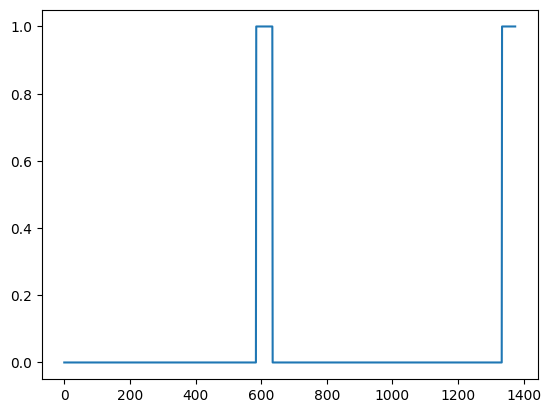

In [ ]:
arr1 = insert_ones(np.zeros((1, Ty)), 9700)
plt.plot(insert_ones(arr1, 4251)[0,:])
print("sanity checks:", arr1[0][1333], arr1[0][634], arr1[0][635])

**Создание обучающего примера**

In [ ]:
def create_training_example(background, activates, negatives, Ty):
    """
    Creates a training example with a given background, activates, and negatives.

    Arguments:
    background -- a 10 second background audio recording
    activates -- a list of audio segments of the word "activate"
    negatives -- a list of audio segments of random words that are not "activate"
    Ty -- The number of time steps in the output

    Returns:
    x -- the spectrogram of the training example
    y -- the label at each time step of the spectrogram
    """

    # Make background quieter
    background = background - 20

    # Step 1: Initialize y (label vector) of zeros (≈ 1 line)
    y = np.zeros(shape=(1, Ty))

    # Step 2: Initialize segment times as empty list (≈ 1 line)
    previous_segments = []

    # Select 0-4 random "activate" audio clips from the entire list of "activates" recordings
    number_of_activates = np.random.randint(0, 5)
    random_indices = np.random.randint(len(activates), size=number_of_activates)
    random_activates = [activates[i] for i in random_indices]

    # Step 3: Loop over randomly selected "activate" clips and insert in background
    for one_random_activate in random_activates:
        # Insert the audio clip on the background
        background, segment_time = insert_audio_clip(background, one_random_activate, previous_segments)
        # Retrieve segment_start and segment_end from segment_time
        segment_start, segment_end = segment_time
        # Insert labels in "y" at segment_end
        y = insert_ones(y, segment_end)

    # Select 0-2 random negatives audio recordings from the entire list of "negatives" recordings
    number_of_negatives = np.random.randint(0, 3)
    random_indices = np.random.randint(len(negatives), size=number_of_negatives)
    random_negatives = [negatives[i] for i in random_indices]


    # Step 4: Loop over randomly selected negative clips and insert in background
    for random_negative in random_negatives:
        # Insert the audio clip on the background
        background, _ = insert_audio_clip(background, random_negative, previous_segments)


    # Standardize the volume of the audio clip
    background = match_target_amplitude(background, -20.0)

    # Export new training example
    file_handle = background.export("train" + ".wav", format="wav")

    # Get and plot spectrogram of the new recording (background with superposition of positive and negatives)
    x = graph_spectrogram("train.wav")

    return x, y

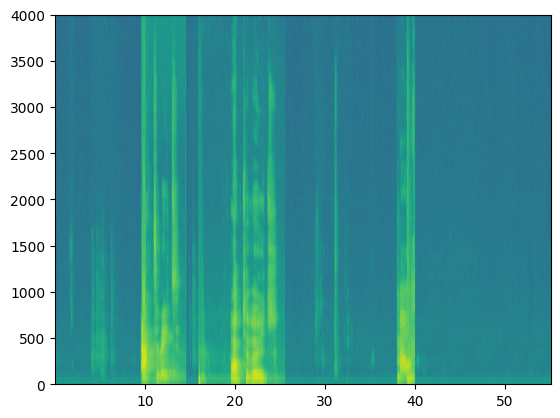

In [ ]:
# Set the random seed
np.random.seed(18)
x, y = create_training_example(backgrounds[0], activates, negatives, Ty)

Теперь вы можете прослушать созданный обучающий пример и сравнить его со спектрограммой, сгенерированной выше.

In [ ]:
IPython.display.Audio("train.wav")

Вы можете построить соответствующие метки для сгенерированного обучающего примера

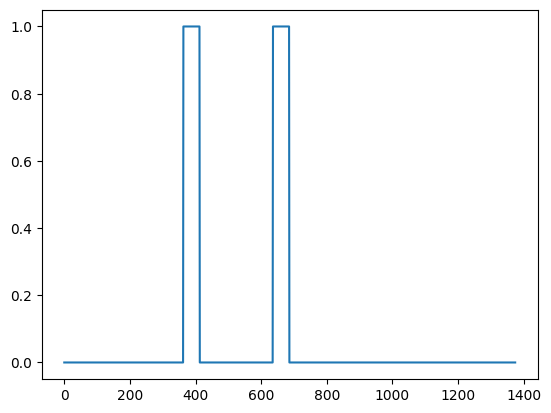

In [ ]:
plt.plot(y[0])

<a name='2-3'></a>
## 2.3 - Создание датасета

Мы создали код, необходимый для создания одного обучающего примера.

Теперь создать датасет

(чтобы сэкономить время, мы создаем обучающий набор меньшего размера из 32 примеров)

0
10
20
30


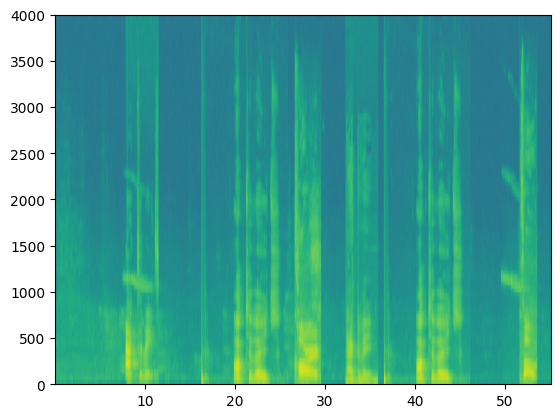

In [ ]:
np.random.seed(4543)
nsamples = 32
X = []
Y = []
for i in range(0, nsamples):
    if i%10 == 0:
        print(i)
    x, y = create_training_example(backgrounds[i % 2], activates, negatives, Ty)
    #print(x.swapaxes(0,1).shape)
    X.append(x.swapaxes(0,1))
    Y.append(y.swapaxes(0,1))
X = np.array(X)
Y = np.array(Y)

Можно сохранить созданный датасет

In [ ]:
# Save the data for further uses
#np.save(f'/content/drive/MyDrive/projTriggerWord/dataset/X.npy', X)
#np.save(f'/content/drive/MyDrive/projTriggerWord/dataset/Y.npy', Y)


In [ ]:
# Load the preprocessed training examples
#X = np.load("/content/drive/MyDrive/projTriggerWord/dataset/X.npy")
#Y = np.load("/content/drive/MyDrive/projTriggerWord/dataset/Y.npy")

**Dev-набор**

Загрузим набор, в нем реальный звук, а не синтезированный.

In [ ]:
# Load preprocessed dev set examples
X_dev = np.load("/content/drive/MyDrive/projTriggerWord/dataset/X_dev.npy")
Y_dev = np.load("/content/drive/MyDrive/projTriggerWord/dataset/Y_dev.npy")

<a name='3'></a>
# 3 - Построение модели и запуск

В модели будут использоваться 1-D сверточные слои, GRU слои и dense слои.

In [ ]:
from tensorflow.keras.callbacks import ModelCheckpoint
from tensorflow.keras.models import Model, load_model, Sequential
from tensorflow.keras.layers import Dense, Activation, Dropout, Input, Masking, TimeDistributed, LSTM, Conv1D
from tensorflow.keras.layers import GRU, Bidirectional, BatchNormalization, Reshape
from tensorflow.keras.optimizers import Adam

<a name='3-1'></a>
## 3.1 - Построение модели

Наша цель - создать сеть, которая будет принимать спектрограмму и выдавать сигнал при обнаружении триггерного слова. Эта сеть будет использовать 4 слоя:

* A convolutional layer
* Two GRU layers
* A dense layer.

In [ ]:
def modelf(input_shape):
    """
    Function creating the model's graph in Keras.

    Argument:
    input_shape -- shape of the model's input data (using Keras conventions)

    Returns:
    model -- Keras model instance
    """

    X_input = Input(shape = input_shape)


    # Step 1: CONV layer (≈4 lines)
    # Add a Conv1D with 196 units, kernel size of 15 and stride of 4
    X = Conv1D(filters=196,kernel_size=15,strides=4)(X_input)
    # Batch normalization
    X = BatchNormalization()(X)
    # ReLu activation
    X = Activation("relu")(X)
    # dropout (use 0.8)
    X = Dropout(rate=0.8)(X)

    # Step 2: First GRU Layer (≈4 lines)
    # GRU (use 128 units and return the sequences)
    X = GRU(units=128, return_sequences = True)(X)
    # dropout (use 0.8)
    X = Dropout(rate=0.8)(X)
    # Batch normalization.
    X = BatchNormalization()(X)

    # Step 3: Second GRU Layer (≈4 lines)
    # GRU (use 128 units and return the sequences)
    X = GRU(units=128, return_sequences = True)(X)
    # dropout (use 0.8)
    X = Dropout(rate=0.8)(X)
    # Batch normalization
    X = BatchNormalization()(X)
    # dropout (use 0.8)
    X = Dropout(rate=0.8)(X)

    # Step 4: Time-distributed dense layer (≈1 line)
    # TimeDistributed  with sigmoid activation
    X = TimeDistributed(Dense(1, activation = "sigmoid"))(X)


    model = Model(inputs = X_input, outputs = X)

    return model

In [ ]:
model = modelf(input_shape = (Tx, n_freq))

Информация о модели

In [ ]:
model.summary()

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 5511, 101)]       0         
                                                                 
 conv1d (Conv1D)             (None, 1375, 196)         297136    
                                                                 
 batch_normalization (Batch  (None, 1375, 196)         784       
 Normalization)                                                  
                                                                 
 activation (Activation)     (None, 1375, 196)         0         
                                                                 
 dropout (Dropout)           (None, 1375, 196)         0         
                                                                 
 gru (GRU)                   (None, 1375, 128)         125184    
                                                             

**Expected Output**:

<table>
    <tr>
        <td>
            **Total params**
        </td>
        <td>
           523,329
        </td>
    </tr>
    <tr>
        <td>
            **Trainable params**
        </td>
        <td>
           522,425
        </td>
    </tr>
    <tr>
        <td>
            **Non-trainable params**
        </td>
        <td>
           904
        </td>
    </tr>
</table>

The output of the network is of shape (None, 1375, 1) while the input is (None, 5511, 101). The Conv1D has reduced the number of steps from 5511 to 1375.

<a name='3-2'></a>
## 3.2 - Fine-tune

* Для обучения распознаванию триггерных слов требуется много времени.
* Загрузим модель, обученную модель около 3 часов на графическом процессоре, используя архитектуру, которую вы построили выше, и большой обучающий набор, состоящий примерно из 4000 примеров.

In [ ]:
from tensorflow.keras.models import model_from_json

json_file = open('/content/drive/MyDrive/projTriggerWord/models/model_new8.json', 'r')
loaded_model_json = json_file.read()
json_file.close()
model = model_from_json(loaded_model_json)
model.load_weights('/content/drive/MyDrive/projTriggerWord/models/model_new8.h5')

In [ ]:
from tensorflow.keras.models import model_from_json

json_file = open('/content/drive/MyDrive/projTriggerWord/models/model.json', 'r')
loaded_model_json = json_file.read()
json_file.close()
model = model_from_json(loaded_model_json)
model.load_weights('/content/drive/MyDrive/projTriggerWord/models/model.h5')

Если вы собираетесь точно настроить предварительно обученную модель, важно, чтобы вы заблокировали веса всех ваших слоев пакетной нормализации. Если вы собираетесь обучать новую модель с нуля, пропустите следующую ячейку.

In [ ]:
model.layers[2].trainable = False
model.layers[7].trainable = False
model.layers[10].trainable = False

Вы можете дополнительно обучить модель, используя оптимизатор Adam и двоичную перекрестную потерю энтропии, следующим образом.

Это будет выполняться быстро, потому что мы тренируемся только для двух эпох и с небольшим обучающим набором из 32 примеров.

In [ ]:
opt = Adam(learning_rate=1e-6, beta_1=0.9, beta_2=0.999)
model.compile(loss='binary_crossentropy', optimizer=opt, metrics=["accuracy"])

In [ ]:
model.fit(X, Y, batch_size = 16, epochs=1)

2/2 [==============================] - 15s 3s/step - loss: 0.2049 - accuracy: 0.9368


<a name='3-3'></a>
## 3.3 - Тестирование модели

Наконец, давайте посмотрим, как наша модель работает на dev-наборе

In [ ]:
loss, acc, = model.evaluate(X_dev, Y_dev)
print("Dev set accuracy = ", acc)

1/1 [==============================] - 3s 3s/step - loss: 0.1887 - accuracy: 0.9240
Dev set accuracy =  0.9239563345909119


Выглядит довольно неплохо!
* Однако точность - не самый лучший показатель для этой задачи
* Поскольку метки сильно смещены к 0, нейронная сеть, которая просто выводит 0, получила бы точность чуть более 90%.
* Мы могли бы определить более полезные показатели, такие как оценка Формулы-1 или точность/отзыв.
* Давайте не будем утруждать себя этим здесь, а вместо этого просто эмпирически посмотрим, как модель справляется с некоторыми предсказаниями.

<a name='3-4'></a>
## 3.4 - Составление прогнозов

Теперь, когда вы создали рабочую модель для определения триггерных слов, давайте использовать ее для составления прогнозов. Этот фрагмент кода запускает аудио (сохраненное в wav-файле) по сети.

In [ ]:
def detect_triggerword(filename):
    plt.subplot(2, 1, 1)

    # Correct the amplitude of the input file before prediction
    audio_clip = AudioSegment.from_wav(filename)
    audio_clip = match_target_amplitude(audio_clip, -20.0)
    file_handle = audio_clip.export("tmp.wav", format="wav")
    filename = "tmp.wav"

    x = graph_spectrogram(filename)
    # the spectrogram outputs (freqs, Tx) and we want (Tx, freqs) to input into the model
    x  = x.swapaxes(0,1)
    x = np.expand_dims(x, axis=0)
    predictions = model.predict(x)
    #print(predictions[0][350:400])

    plt.subplot(2, 1, 2)
    plt.plot(predictions[0,:,0])
    plt.ylabel('probability')
    plt.show()
    return predictions

Вставим звуковой сигнал, подтверждающий "активацию" триггера

In [ ]:
chime_file = "/content/drive/MyDrive/projTriggerWord/audio_examples/chime.wav"
def chime_on_activate(filename, predictions, threshold):
    audio_clip = AudioSegment.from_wav(filename)
    chime = AudioSegment.from_wav(chime_file)
    Ty = predictions.shape[1]
    # Step 1: Initialize the number of consecutive output steps to 0
    consecutive_timesteps = 0
    i = 0
    # Step 2: Loop over the output steps in the y
    while i < Ty:
        # Step 3: Increment consecutive output steps
        consecutive_timesteps += 1
        # Step 4: If prediction is higher than the threshold for 20 consecutive output steps have passed
        if consecutive_timesteps > 20:
            # Step 5: Superpose audio and background using pydub
            audio_clip = audio_clip.overlay(chime, position = ((i / Ty) * audio_clip.duration_seconds) * 1000)
            # Step 6: Reset consecutive output steps to 0
            consecutive_timesteps = 0
            i = 75 * (i // 75 + 1)
            continue
        # if amplitude is smaller than the threshold reset the consecutive_timesteps counter
        if predictions[0, i, 0] < threshold:
            consecutive_timesteps = 0
        i += 1

    audio_clip.export("chime_output2.wav", format='wav')

Тестирование на Dev-примерах

Давайте посмотрим, как наша модель работает с двумя аудиоклипами из dev-набора, которые она до этого не виделп. Давайте сначала послушаем два клипа из набора для разработки.

In [ ]:
IPython.display.Audio("/content/drive/MyDrive/projTriggerWord/raw_data/dev/1.wav")

In [ ]:
IPython.display.Audio("/content/drive/MyDrive/projTriggerWord/raw_data/dev/2.wav")

Звуковой сигнал, подтверждающий "активацию" триггера

In [ ]:
IPython.display.Audio("/content/drive/MyDrive/projTriggerWord/audio_examples/chime.wav")

1/1 [==============================] - 0s 172ms/step


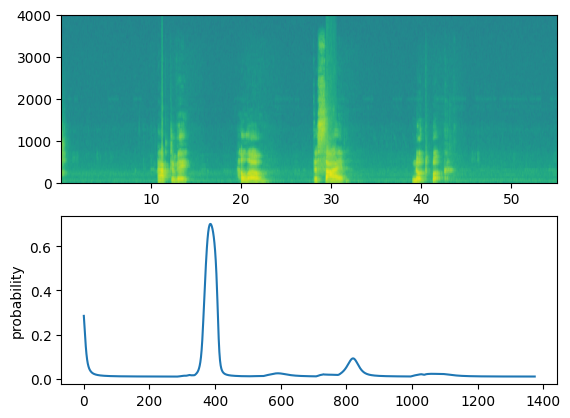

In [ ]:
filename = "/content/drive/MyDrive/projTriggerWord/raw_data/dev/1.wav"
prediction = detect_triggerword(filename)
chime_on_activate(filename, prediction, 0.5)
IPython.display.Audio("chime_output2.wav")

1/1 [==============================] - 0s 157ms/step


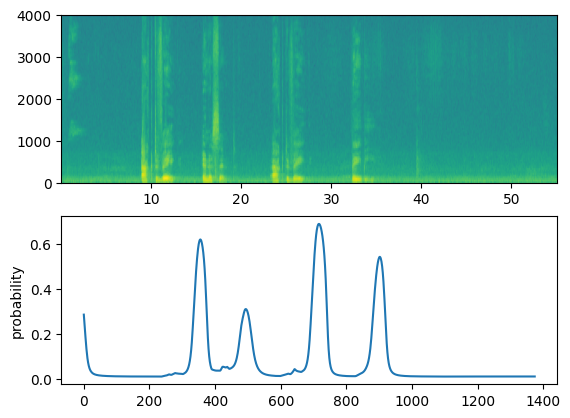

In [ ]:
filename  = "/content/drive/MyDrive/projTriggerWord/raw_data/dev/2.wav"
prediction = detect_triggerword(filename)
chime_on_activate(filename, prediction, 0.5)
IPython.display.Audio("chime_output2.wav")

**Модель отлично справилась с данными примерами!**

<a name='3-5'></a>
## 3.5 - Попробуйте свою аудиозапись


* Запишите 10-секундный аудиоклип, в котором вы произносите слово "активировать" и другие случайные слова, и загрузите его как "myaudio.wav".

* Обязательно загрузите аудио в виде wav-файла.

In [ ]:
# Preprocess the audio to the correct format
def preprocess_audio(filename):
    # Trim or pad audio segment to 10000ms
    padding = AudioSegment.silent(duration=10000)
    segment = AudioSegment.from_wav(filename)[:10000]
    segment = padding.overlay(segment)
    # Set frame rate to 44100
    segment = segment.set_frame_rate(44100)
    # Export as wav
    segment.export(filename, format='wav')

укажите путь к вашему файлу в переменной ниже.

In [ ]:
your_filename = "/content/drive/MyDrive/projTriggerWord/audio_examples/my_audio.wav"

In [ ]:
preprocess_audio(your_filename)
IPython.display.Audio(your_filename) # listen to the audio you uploaded

Наконец, используйте модель, чтобы предсказать, когда вы скажете "активировать" в 10-секундном аудиоклипе, и вызвать звуковой сигнал. Если звуковые сигналы добавляются неправильно, попробуйте настроить значение chime_threshold.

1/1 [==============================] - 0s 208ms/step


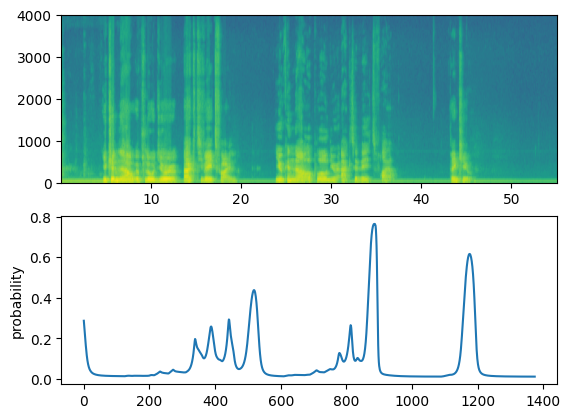

In [ ]:
chime_threshold = 0.5
prediction = detect_triggerword(your_filename)
chime_on_activate(your_filename, prediction, chime_threshold)
IPython.display.Audio("./chime_output2.wav")